# Lab 1: Intro to TensorFlow and Music Generation with RNNs

# Part 2: Music Generation with RNNs
실험실의 이 부분에서는 음악 생성을 위한 순환 신경망(RNN) 구축에 대해 알아보겠습니다. 우리는 ABC 표기법으로 원시 악보의 패턴을 학습한 후 이 모델을 사용하여 새로운 음악을 생성할 것입니다.

## 2.1 Dependencies


In [1]:
# Import Tensorflow 2.0
%tensorflow_version 2.x
import tensorflow as tf 

# Download and import the MIT 6.S191 package
!pip install mitdeeplearning
import mitdeeplearning as mdl

# Import all remaining packages
import numpy as np
import os
import time
import functools
from IPython import display as ipythondisplay
from tqdm import tqdm
!apt-get install abcmidi timidity > /dev/null 2>&1

# Check that we are using a GPU, if not switch runtimes
#   using Runtime > Change Runtime Type > GPU
assert len(tf.config.list_physical_devices('GPU')) > 0

     |████████████████████████████████| 2.1 MB 5.1 MB/s 
  Created wheel for mitdeeplearning: filename=mitdeeplearning-0.2.0-py3-none-any.whl size=2115442 sha256=378088b0b5373b56fb866feeefa32e9cb907befd8d62457d5e7e1047a4a7cd97
  Stored in directory: /root/.cache/pip/wheels/9a/b9/4f/99b7c8c5c75355550b83e1fcfc02956fb40c35eb01e2262877
Successfully built mitdeeplearning


## 2.2 Dataset

In [2]:
# Download the dataset
songs = mdl.lab1.load_training_data()

# Print one of the songs to inspect it in greater detail!
example_song = songs[0]
print("\nExample song: ")
print(example_song)

Found 817 songs in text

Example song: 
X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


X:song number

T:Composer

Z:민요 종류

M:박자

L:1/8 

K:Major

데이터 전처리

In [3]:
import pandas as pd
my_data=[]
my_song = []
songstr=""
my_joined=""
for i in songs:
  my_song_temp=i.split('\n')
  for j in my_song_temp:
    if j=='':
      continue
    elif j[-1] == '!':
      songstr=songstr+'\n'+j
  
  my_joined=my_joined+'\n'.join(my_song_temp[2:6])
  my_joined=my_joined+songstr[1:]+'\n\n'
  songstr=""
    
my_joined

'Z: id:dc-hornpipe-1\nM:C|\nL:1/8\nK:D Major(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!\ndAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!\nAG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!\nFAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!\n\nZ: id:dc-hornpipe-2\nM:C|\nL:1/8\nK:G MajorGF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!\nDGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!\nGA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!\nB2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!\n\nZ: id:dc-hornpipe-3\nM:C|\nL:1/8\nK:D Majorag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!\n(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!\n(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!\nGFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!\nag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!\n(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|!\n\nZ: id:dc-hornpipe-4\nM:C|\nL:1/8\nK:D MixolydianAG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA G2AG|!\nF2FA GFD2|de (3fed d^cAG|AdcA GcAG|F2

In [4]:
for i in range(len(songs)):
  print(songs[i])

X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!
X:2
T:An Buachaill Dreoite
Z: id:dc-hornpipe-2
M:C|
L:1/8
K:G Major
GF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!
DGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!
GA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!
B2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!
X:3
T:Belfast
Z: id:dc-hornpipe-3
M:C|
L:1/8
K:D Major
ag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!
(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!
(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!
GFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!
ag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!
(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|!
X:4
T:Blackbird
Z: id:dc-hornpipe-4
M:C|
L:1/8
K:D Mixolydian
AG|F2FA GFD2|de (3fed d^cAF|G2GF GFDE|FdcA

ABC 표기법의 노래를 오디오 파형으로 쉽게 변환하여 재생할 수 있습니다. 

In [5]:
# Convert the ABC notation to audio file and listen to it
mdl.lab1.play_song(example_song)

```
def play_song(song):
    basename = save_song_to_abc(song)
    ret = abc2wav(basename+'.abc')
    if ret == 0: #did not suceed
        return play_wav(basename+'.wav')
    return None
```


```
def save_song_to_abc(song, filename="tmp"):
    save_name = "{}.abc".format(filename)
    with open(save_name, "w") as f:
        f.write(song)
    return filename
```



  

In [6]:
print(example_song)

X:1
T:Alexander's
Z: id:dc-hornpipe-1
M:C|
L:1/8
K:D Major
(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!
dAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!
AG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!
FAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!


*제목과 작곡가 같은 정보는 어떻게 인식할까?*

한 가지 중요한 점은 이 음악 표기법이 단순히 연주되는 음에 대한 정보를 담고 있는 것이 아니라 추가적으로 노래 제목, 키, 템포와 같은 메타 정보가 있다는 것입니다. 텍스트 파일에 존재하는 다양한 문자의 수가 학습 문제의 복잡성에 어떤 영향을 미칠까요? 텍스트 데이터에 대한 수치 표현을 생성할 때 이것은 곧 중요해질 것입니다.

In [7]:
# Join our list of song strings into a single string containing all songs
songs_joined = "\n\n".join(songs) 

# Find all unique characters in the joined string
vocab = sorted(set(songs_joined))
print("There are", len(vocab), "unique characters in the dataset")

There are 83 unique characters in the dataset


In [8]:
songs_joined

'X:1\nT:Alexander\'s\nZ: id:dc-hornpipe-1\nM:C|\nL:1/8\nK:D Major\n(3ABc|dAFA DFAd|fdcd FAdf|gfge fefd|(3efe (3dcB A2 (3ABc|!\ndAFA DFAd|fdcd FAdf|gfge fefd|(3efe dc d2:|!\nAG|FAdA FAdA|GBdB GBdB|Acec Acec|dfaf gecA|!\nFAdA FAdA|GBdB GBdB|Aceg fefd|(3efe dc d2:|!\n\nX:2\nT:An Buachaill Dreoite\nZ: id:dc-hornpipe-2\nM:C|\nL:1/8\nK:G Major\nGF|DGGB d2GB|d2GF Gc (3AGF|DGGB d2GB|dBcA F2GF|!\nDGGB d2GF|DGGF G2Ge|fgaf gbag|fdcA G2:|!\nGA|B2BG c2cA|d2GF G2GA|B2BG c2cA|d2DE F2GA|!\nB2BG c2cA|d^cde f2 (3def|g2gf gbag|fdcA G2:|!\n\nX:3\nT:Belfast\nZ: id:dc-hornpipe-3\nM:C|\nL:1/8\nK:D Major\nag|(3faf df AdFA|DFAd f2ef|gbec dfAF|GABG E2ag|!\n(3faf df AdFA|DFAd f2ef|gbed cABc|d2f2 d2:|!\n(3DEF|GFGA Bcde|fgfe dcdB|A2f2 fef2|G2e2 ede2|!\nGFGA Bcde|fgfe dcdB|Afed cABc|d2f2 d2:|!\nag|(3fgf (3efe (3ded (3cdc|(3BcB (3ABA G2ba|(3gag (3fgf (3efe (3ded|(3cdc (3BcB A2ag|!\n(3fgf (3efe (3ded (3cdc|(3BcB (3ABA (3GAG (3FGF|Eged cABc|d2f2 d2:|!\n\nX:4\nT:Blackbird\nZ: id:dc-hornpipe-4\nM:C|\nL:1/8\nK:D Mixolydi

## 2.3 Process the dataset for the learning task
한발 물러서서 우리의 예측 과제를 생각해 봅시다. ABC 음악의 패턴을 학습하도록 RNN 모델을 교육한 다음 이 모델을 사용하여 학습된 정보를 기반으로 새로운 음악을 생성(예측)하려고 합니다.

이것을 분해하여 우리가 이 모델에 정말로 묻고 싶은 것은, 주어진 캐릭터나 일련의 캐릭터들, 가장 가능성 있는 다음 캐릭터는 무엇인가 하는 것입니다. 이 작업을 수행할 수 있도록 모델을 교육할 것입니다.

이를 위해 모델에 일련의 문자를 입력하고 각 시간 단계에서 다음 문자를 예측하도록 모델을 훈련할 것입니다. RNN은 이전에 본 요소에 의존하는 내부 상태를 유지하므로, 주어진 순간까지 보이는 모든 문자에 대한 정보가 예측을 생성할 때 고려합니다.

### Vectorize the text
RNN 모델을 교육하기 전에 텍스트 기반 데이터 세트의 수치 표현을 만들어야 합니다. 이를 위해 문자를 숫자에 매핑하는 룩업 테이블과 숫자를 다시 문자에 매핑하는 룩업 테이블을 생성합니다. 우리가 본문에 있는 독특한 문자들을 확인했다는 것을 기억하세요!

In [9]:
### Define numerical representation of text ###

# Create a mapping from character to unique index.
# For example, to get the index of the character "d", 
#   we can evaluate `char2idx["d"]`.  
char2idx = {u:i for i, u in enumerate(vocab)}

# Create a mapping from indices to characters. This is
#   the inverse of char2idx and allows us to convert back
#   from unique index to the character in our vocabulary.
idx2char = np.array(vocab)

이것은 우리에게 각 문자에 대한 정수 표현을 제공합니다. 텍스트의 고유한 문자(즉, 우리의 어휘)가 0에서 len(고유)까지의 인덱스로 매핑되는지 관찰합니다. 데이터 세트의 수치 표현을 살펴보겠습니다.

In [10]:
print('{')
for char,_ in zip(char2idx, range(len(char2idx))):
    print('  {:4s}: {:3d},'.format(repr(char), char2idx[char]))
print('}')

{
  '\n':   0,
  ' ' :   1,
  '!' :   2,
  '"' :   3,
  '#' :   4,
  "'" :   5,
  '(' :   6,
  ')' :   7,
  ',' :   8,
  '-' :   9,
  '.' :  10,
  '/' :  11,
  '0' :  12,
  '1' :  13,
  '2' :  14,
  '3' :  15,
  '4' :  16,
  '5' :  17,
  '6' :  18,
  '7' :  19,
  '8' :  20,
  '9' :  21,
  ':' :  22,
  '<' :  23,
  '=' :  24,
  '>' :  25,
  'A' :  26,
  'B' :  27,
  'C' :  28,
  'D' :  29,
  'E' :  30,
  'F' :  31,
  'G' :  32,
  'H' :  33,
  'I' :  34,
  'J' :  35,
  'K' :  36,
  'L' :  37,
  'M' :  38,
  'N' :  39,
  'O' :  40,
  'P' :  41,
  'Q' :  42,
  'R' :  43,
  'S' :  44,
  'T' :  45,
  'U' :  46,
  'V' :  47,
  'W' :  48,
  'X' :  49,
  'Y' :  50,
  'Z' :  51,
  '[' :  52,
  ']' :  53,
  '^' :  54,
  '_' :  55,
  'a' :  56,
  'b' :  57,
  'c' :  58,
  'd' :  59,
  'e' :  60,
  'f' :  61,
  'g' :  62,
  'h' :  63,
  'i' :  64,
  'j' :  65,
  'k' :  66,
  'l' :  67,
  'm' :  68,
  'n' :  69,
  'o' :  70,
  'p' :  71,
  'q' :  72,
  'r' :  73,
  's' :  74,
  't' :  75,
  'u' :  7

In [11]:
### Vectorize the songs string ###

'''TODO: Write a function to convert the all songs string to a vectorized
    (i.e., numeric) representation. Use the appropriate mapping
    above to convert from vocab characters to the corresponding indices.

  NOTE: the output of the `vectorize_string` function 
  should be a np.array with `N` elements, where `N` is
  the number of characters in the input string
'''

def vectorize_string(string):
  vectorized_output = np.array([char2idx[char] for char in string])
  return vectorized_output
  # TODO

vectorized_songs = vectorize_string(songs_joined)

In [12]:
vectorized_songs = vectorize_string(my_joined)

In [13]:
vectorized_songs.shape

(180801,)

In [14]:
vectorized_songs

array([51, 22,  1, ...,  2,  0,  0])

또한 텍스트의 첫 번째 부분이 정수 표현으로 매핑되는 방식을 볼 수 있습니다:

In [15]:
print ('{} ---- characters mapped to int ----> {}'.format(repr(songs_joined[:10]), vectorized_songs[:10]))
# check that vectorized_songs is a numpy array
assert isinstance(vectorized_songs, np.ndarray), "returned result should be a numpy array"

'X:1\nT:Alex' ---- characters mapped to int ----> [51 22  1 64 59 22 59 58  9 63]


### Create training examples and targets
우리의 다음 단계는 실제로 텍스트를 훈련 중에 사용할 예제 시퀀스로 나누는 것입니다. RNN에 입력하는 각 입력 시퀀스는 텍스트의 seq_length 문자를 포함합니다. 또한 각 입력 시퀀스에 대한 목표 시퀀스를 정의해야 하며, 이는 다음 문자를 예측하기 위한 RNN 교육에 사용됩니다. 각 입력에 대해 오른쪽으로 한 문자를 이동시킨 것을 제외하고 해당 대상은 동일한 길이의 텍스트를 포함합니다.

이렇게 하려면 텍스트를 seq_length+1의 청크로 나누어야 합니다. seq_length가 4이고 우리의 텍스트가 "Hello"라고 가정합시다. 그러면 우리의 입력 수열은 "Hell"이고 목표 수열은 "ello"이다.

그런 다음 배치 방법을 사용하면 이 문자 인덱스 스트림을 원하는 크기의 시퀀스로 변환할 수 있습니다.

In [16]:
### Batch definition to create training examples ###

def get_batch(vectorized_songs, seq_length, batch_size):
  # the length of the vectorized songs string
  n = vectorized_songs.shape[0] - 1
  # randomly choose the starting indices for the examples in the training batch
  # 임의 표본 추출
  # [0~200679-seq_length] 모집단에서 batch_size 만큼의 표본 추출
  idx = np.random.choice(n-seq_length, batch_size)

  '''TODO: construct a list of input sequences for the training batch'''
  input_batch = [vectorized_songs[i : i+seq_length] for i in idx]
  # input_batch = # TODO
  '''TODO: construct a list of output sequences for the training batch'''
  output_batch = [vectorized_songs[i+1 : i+seq_length+1] for i in idx]
  # output_batch = # TODO

  # x_batch, y_batch provide the true inputs and targets for network training
  # reshape(행, 열)로 바꿔줌
  x_batch = np.reshape(input_batch, [batch_size, seq_length])
  y_batch = np.reshape(output_batch, [batch_size, seq_length])
  return x_batch, y_batch


# Perform some simple tests to make sure your batch function is working properly! 
test_args = (vectorized_songs, 10, 2)
if not mdl.lab1.test_batch_func_types(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_shapes(get_batch, test_args) or \
   not mdl.lab1.test_batch_func_next_step(get_batch, test_args): 
   print("======\n[FAIL] could not pass tests")
else: 
   print("======\n[PASS] passed all tests!")

[PASS] test_batch_func_types
[PASS] test_batch_func_shapes
[PASS] test_batch_func_next_step
[PASS] passed all tests!


이러한 각 벡터에 대해 각 인덱스는 단일 시간 단계에서 처리됩니다. 따라서 0번 입력의 경우 모델은 시퀀스의 첫 번째 문자에 대한 인덱스를 수신하고 다음 문자의 인덱스를 예측하려고 합니다. 다음 시간 단계에서 동일한 작업을 수행하지만, RNN은 이전 단계의 정보, 즉 현재 입력 외에 업데이트된 상태를 고려합니다.

본문의 처음 몇 문자에 대해 이것이 어떻게 작동하는지 살펴봄으로써 이것을 구체화할 수 있습니다:

In [17]:
x_batch, y_batch = get_batch(vectorized_songs, seq_length=5, batch_size=1)

for i, (input_idx, target_idx) in enumerate(zip(np.squeeze(x_batch), np.squeeze(y_batch))):
    print("Step {:3d}".format(i))
    print("  input: {} ({:s})".format(input_idx, repr(idx2char[input_idx])))
    print("  expected output: {} ({:s})".format(target_idx, repr(idx2char[target_idx])))

Step   0
  input: 11 ('/')
  expected output: 60 ('e')
Step   1
  input: 60 ('e')
  expected output: 11 ('/')
Step   2
  input: 11 ('/')
  expected output: 82 ('|')
Step   3
  input: 82 ('|')
  expected output: 56 ('a')
Step   4
  input: 56 ('a')
  expected output: 60 ('e')


## 2.4 The Recurrent Neural Network (RNN) model
이제 ABC 음악 데이터 세트에서 RNN 모델을 정의하고 교육한 다음 이 훈련된 모델을 사용하여 새로운 노래를 생성할 준비가 되었습니다. 이전 섹션에서 생성한 데이터 세트의 노래 스니펫 배치를 사용하여 RNN을 교육합니다.

이 모델은 상태 벡터를 사용하여 연속 문자 간의 시간 관계에 대한 정보를 유지하는 LSTM 아키텍처를 기반으로 한다. 그런 다음 LSTM의 최종 출력은 완전히 연결된 밀도 레이어로 공급되며, 여기서 어휘의 각 문자에 대해 소프트맥스를 출력한 다음 이 분포에서 샘플을 추출하여 다음 문자를 예측합니다.

이 실험실의 첫 부분에서 소개했듯이 Keras API, 특히 tf.keras.Sequntial를 사용하여 모형을 정의합니다. 세 개의 도면층이 모델을 정의하는 데 사용됩니다:
  - tf.keras.layers.Embedding : 각 문자의 숫자를 Embedding_dimensions를 가진 벡터에 매핑하는 훈련 가능한 룩업 테이블로 구성된 인풋 레이어
  - tf.keras.layers.LSTM : units=rnn_units 크기를 가진 LSTM network
  - tf.keras.layers.Dense : vocab_size 아웃풋 레이어

### Define the RNN model
이제 모델을 실제로 만들기 위해 사용할 함수를 정의하겠습니다.

In [18]:
def LSTM(rnn_units): 
  return tf.keras.layers.LSTM(
    rnn_units, 
    return_sequences=True, 
    recurrent_initializer='glorot_uniform',
    recurrent_activation='sigmoid',
    stateful=True,
  )

build_model 함수 내에서 RNN 모델을 정의한 다음 방금 정의한 함수를 호출하여 모델을 인스턴스화합니다!

In [19]:
### Defining the RNN Model ###

'''TODO: Add LSTM and Dense layers to define the RNN model using the Sequential API.'''
def build_model(vocab_size, embedding_dim, rnn_units, batch_size):
  model = tf.keras.Sequential([
    # Layer 1: Embedding layer to transform indices into dense vectors 
    #   of a fixed embedding size
    tf.keras.layers.Embedding(vocab_size, embedding_dim, batch_input_shape=[batch_size, None]),

    # Layer 2: LSTM with `rnn_units` number of units. 
    # TODO: Call the LSTM function defined above to add this layer.
    LSTM(rnn_units),

    # Layer 3: Dense (fully-connected) layer that transforms the LSTM output
    #   into the vocabulary size. 
    # TODO: Add the Dense layer.
    tf.keras.layers.Dense(vocab_size)
  ])

  return model

# Build a simple model with default hyperparameters. You will get the 
#   chance to change these later.
model = build_model(len(vocab), embedding_dim=256, rnn_units=1024, batch_size=32)

### Test out the RNN model
우리 모델이 예상대로 작동하는지 확인하기 위해 몇 가지 간단한 검사를 하는 것은 항상 좋은 생각입니다.

첫째, 우리는 모델을 사용할 수 있습니다.요약 기능을 사용하여 모델의 내부 작업 요약을 출력합니다. 여기서는 모델의 레이어, 각 레이어의 출력 형태, 배치 크기 등을 확인할 수 있습니다.

In [20]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (32, None, 256)           21248     
                                                                 
 lstm (LSTM)                 (32, None, 1024)          5246976   
                                                                 
 dense (Dense)               (32, None, 83)            85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


In [21]:
x, y = get_batch(vectorized_songs, seq_length=100, batch_size=32)
pred = model(x)
print("Input shape:      ", x.shape, " # (batch_size, sequence_length)")
print("Prediction shape: ", pred.shape, "# (batch_size, sequence_length, vocab_size)")

Input shape:       (32, 100)  # (batch_size, sequence_length)
Prediction shape:  (32, 100, 83) # (batch_size, sequence_length, vocab_size)


### Predictions from the untrained model
우리의 훈련받지 않은 모델이 무엇을 예측하는지 살펴봅시다.

모델에서 실제 예측을 얻기 위해 문자 어휘에 대한 softmax로 정의되는 출력 분포에서 샘플을 추출한다. 이것은 우리에게 실제 캐릭터 인덱스를 줄 것입니다. 즉, 범주형 분포를 사용하여 예제 예측을 표본으로 추출하고 있습니다. 이것은 각 시간 단계에서 다음 문자(특히 그 색인)에 대한 예측을 제공합니다. 

여기서는 모델이 루프에 갇힐 수 있는 argmax를 단순히 취하는 대신 이 확률 분포에서 표본을 추출한다는 점에 유의해야 합니다.

배치의 첫 번째 예에 대해 이 샘플링을 실행해 보겠습니다.

In [22]:
sampled_indices = tf.random.categorical(pred[0], num_samples=1)
sampled_indices = tf.squeeze(sampled_indices,axis=-1).numpy()
sampled_indices

array([49,  7, 78, 41, 68, 41, 82, 60, 64, 58, 34, 43, 19, 75, 16, 82, 15,
       63, 45, 71, 27, 23, 46, 32, 37,  1, 31, 54, 61, 18, 80, 15, 12, 14,
       49, 21, 31, 25, 45, 74, 44, 27, 37, 45,  3, 68, 81, 30,  7, 57,  6,
       82, 10, 15,  9, 46,  6, 62, 58, 31, 26, 14, 68, 21, 38, 63, 69, 13,
        9, 12,  5,  6, 22, 66, 21, 22, 48, 34, 26, 35, 19, 47, 75, 20, 21,
        0, 36,  6, 20, 15, 71, 33, 67,  5, 23, 66, 78, 42,  8, 46])

이제 다음 항목을 디코딩하여 훈련되지 않은 모델에 의해 예측된 텍스트를 확인할 수 있습니다.

In [23]:
print("Input: \n", repr("".join(idx2char[x[0]])))
print()
print("Next Char Predictions: \n", repr("".join(idx2char[sampled_indices])))

Input: 
 'E2D|!\nGED DED|GFG c2e|dBG GAB|AGF G2:|!\nd|gdB GBd|gdB c2e|dBG GAB|AGE E2D|!\n[1 gdB GBd|gdB c2e|dBG G'

Next Char Predictions: 
 'X)wPmP|eicIR7t4|3hTpB<UGL F^f6y302X9F>TsSBLT"mzE)b(|.3-U(gcFA2m9Mhn1-0\'(:k9:WIAJ7Vt89\nK(83pHl\'<kwQ,U'


## 2.5 Training the model: loss and training operations
이제 모델을 훈련시킬 시간입니다!

이 시점에서 우리의 다음 캐릭터 예측 문제는 표준 분류 문제라고 생각할 수 있습니다. RNN의 이전 상태와 주어진 시간 단계의 입력을 고려할 때, 우리는 다음 문자의 클래스를 예측하고 싶습니다. 즉, 다음 문자를 실제로 예측하는 것입니다.

이 분류 작업에 대한 모델을 훈련하기 위해 교차 crossentropy 손실(음수 로그 우도 손실)의 형태를 사용할 수 있습니다. 구체적으로, 우리는 sparse_categorical_crossentropy loss을 사용할 것입니다. 이 손실은 범주 분류 작업에 정수 대상을 활용하기 때문입니다. 우리는 실제 목표, 즉 레이블과 예측 목표, logits들을 사용하여 손실을 계산하고자 할 것입다.

먼저 훈련되지 않은 모델의 예측 예제를 사용하여 손실을 계산해 봅시다.

In [24]:
### Defining the loss function ###

'''TODO: define the loss function to compute and return the loss between
    the true labels and predictions (logits). Set the argument from_logits=True.'''
def compute_loss(labels, logits):
  loss = tf.keras.losses.sparse_categorical_crossentropy(labels, logits, from_logits=True) # TODO
  return loss

'''TODO: compute the loss using the true next characters from the example batch 
    and the predictions from the untrained model several cells above'''
example_batch_loss = compute_loss(y, pred) # TODO

print("Prediction shape: ", pred.shape, " # (batch_size, sequence_length, vocab_size)") 
print("scalar_loss:      ", example_batch_loss.numpy().mean())

Prediction shape:  (32, 100, 83)  # (batch_size, sequence_length, vocab_size)
scalar_loss:       4.419281


먼저 모델을 교육하기 위한 몇 가지 하이퍼 파라미터를 정의하겠습니다. 우선 일부 매개 변수에 대해 합리적인 값을 제공했습니다. 수업 시간에 배운 내용을 사용하여 여기서 매개 변수 선택을 최적화하는 것은 여러분에게 달려 있습니다!

In [55]:
### Hyperparameter setting and optimization ###

# Optimization parameters:
num_training_iterations = 5000  # Increase this to train longer
batch_size = 4  # Experiment between 1 and 64
seq_length = 250  # Experiment between 50 and 500
learning_rate = 5e-3  # Experiment between 1e-5 and 1e-1

# Model parameters: 
vocab_size = len(vocab)
embedding_dim = 256 
rnn_units = 1024  # Experiment between 1 and 2048

# Checkpoint location: 
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "my_ckpt")

이제, 우리는 우리의 훈련 작업인 최적화 도구와 훈련 기간을 정의하고 이 함수를 사용하여 모델을 훈련시킬 준비가 되었습니다. 최적화 도구 선택과 모델을 교육하는 기간을 실험하고 이러한 변경이 네트워크 출력에 어떤 영향을 미치는지 알아봅니다. 당신이 시도해보고 싶은 몇몇 옵티마이저는 Adam과 Adagrad입니다.

먼저, 우리는 새로운 모델과 옵티마이저를 초기화할 것입니다. 그럼, 우리는 TFGradientTape를 사용하여 역전파 작업을 수행합니다.

또한 교육을 통해 모델의 진행 상황을 출력하여 손실 최소화 여부를 쉽게 시각화할 수 있도록 합니다.

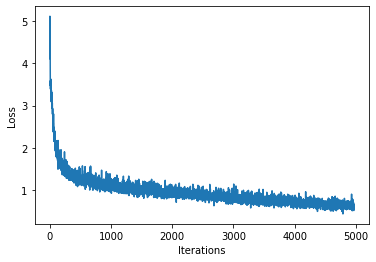

100%|██████████| 5000/5000 [04:38<00:00, 17.92it/s]


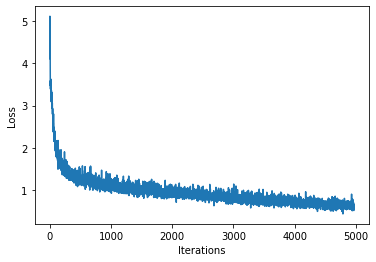

In [56]:
### Define optimizer and training operation ###

'''TODO: instantiate a new model for training using the `build_model`
  function and the hyperparameters created above.'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size)
# model = build_model('''TODO: arguments''')

'''TODO: instantiate an optimizer with its learning rate.
  Checkout the tensorflow website for a list of supported optimizers.
  https://www.tensorflow.org/api_docs/python/tf/keras/optimizers/
  Try using the Adam optimizer to start.'''
optimizer = tf.keras.optimizers.Adam(learning_rate)
# optimizer = # TODO

@tf.function
def train_step(x, y): 
  # Use tf.GradientTape()
  with tf.GradientTape() as tape:
  
    '''TODO: feed the current input into the model and generate predictions'''
    y_hat = model(x) # TODO
    # y_hat = model('''TODO''')
  
    '''TODO: compute the loss!'''
    loss = compute_loss(y, y_hat) # TODO
    # loss = compute_loss('''TODO''', '''TODO''')

  # Now, compute the gradients 
  '''TODO: complete the function call for gradient computation. 
      Remember that we want the gradient of the loss with respect all 
      of the model parameters. 
      HINT: use `model.trainable_variables` to get a list of all model
      parameters.'''
  grads = tape.gradient(loss, model.trainable_variables) # TODO
  # grads = tape.gradient('''TODO''', '''TODO''')
  
  # Apply the gradients to the optimizer so it can update the model accordingly
  optimizer.apply_gradients(zip(grads, model.trainable_variables))
  return loss

##################
# Begin training!#
##################

history = []
plotter = mdl.util.PeriodicPlotter(sec=2, xlabel='Iterations', ylabel='Loss')
if hasattr(tqdm, '_instances'): tqdm._instances.clear() # clear if it exists

for iter in tqdm(range(num_training_iterations)):

  # Grab a batch and propagate it through the network
  x_batch, y_batch = get_batch(vectorized_songs, seq_length, batch_size)
  loss = train_step(x_batch, y_batch)

  # Update the progress bar
  history.append(loss.numpy().mean())
  plotter.plot(history)

  # Update the model with the changed weights!
  if iter % 100 == 0:     
    model.save_weights(checkpoint_prefix)
    
# Save the trained model and the weights
model.save_weights(checkpoint_prefix)

## 2.6 Generate music using the RNN model
이제, 우리는 우리의 훈련된 RNN 모델을 사용하여 음악을 만들 수 있습니다! 음악을 생성할 때, 우리는 모델을 시작하기 위해 어떤 종류의 시드를 공급해야 할 것입니다.

생성된 시드가 있으면 훈련된 RNN을 사용하여 각 연속 문자를 반복적으로 예측할 수 있습니다(우리는 음악에 ABC 표현을 사용하고 있음을 기억하십시오). 보다 구체적으로, RNN이 가능한 연속 문자를 통해 softmax를 출력한다는 것을 상기하십시오. 추론을 위해 이러한 분포에서 반복적으로 표본을 추출한 다음 생성된 노래를 ABC 형식으로 인코딩하는 데 샘플을 사용합니다.

그러면, 우리는 그것을 파일에 쓰고 듣기만 하면 됩니다!

### Restore the latest checkpoint
이 추론 단계를 단순하게 유지하기 위해 우리는 1의 배치 크기를 사용할 것입니다. RNN 상태가 시간 단계에서 시간 단계로 전달되는 방식 때문에 모델은 일단 구축되면 고정된 배치 크기를 수용할 수 있습니다.

다른 batch_size로 모델을 실행하려면 모델을 재작성하고 최신 체크포인트, 즉 교육 중 마지막 체크포인트 이후의 가중치를 복원해야 합니다.

In [57]:
'''TODO: Rebuild the model using a batch_size=1'''
model = build_model(vocab_size, embedding_dim, rnn_units, batch_size=1) # TODO
# model = build_model('''TODO''', '''TODO''', '''TODO''', batch_size=1)

# Restore the model weights for the last checkpoint after training
model.load_weights(tf.train.latest_checkpoint(checkpoint_dir))
model.build(tf.TensorShape([1, None]))

model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (1, None, 256)            21248     
                                                                 
 lstm_7 (LSTM)               (1, None, 1024)           5246976   
                                                                 
 dense_7 (Dense)             (1, None, 83)             85075     
                                                                 
Total params: 5,353,299
Trainable params: 5,353,299
Non-trainable params: 0
_________________________________________________________________


추론을 위해 고정된 batch_size를 1로 입력했습니다.

### The prediction procedure
이제 ABC 음악 형식으로 텍스트를 생성하기 위한 코드를 작성할 준비가 되었습니다.

- 시드 시작 문자열과 RNN 상태를 초기화하고 생성할 문자 수를 설정합니다.

- 시작 문자열과 RNN 상태를 사용하여 다음 예측 문자에 대한 확률 분포를 얻습니다.

- 예측 특성의 지수를 계산하기 위한 다항 분포의 표본입니다. 그런 다음 이 예측 문자를 모형에 대한 다음 입력으로 사용합니다.

- 각 시간 단계에서 업데이트된 RNN 상태가 모델에 다시 공급되어 다음 예측을 수행할 때 더 많은 컨텍스트를 갖게 됩니다. 다음 문자를 예측한 후 업데이트된 RNN 상태는 다시 모델에 피드백되며, 이는 이전 예측에서 더 많은 정보를 얻을 때 데이터의 시퀀스 종속성을 학습하는 방법입니다.

이 코드 블록(네트워크 정의 및 훈련의 일부 측면도 포함)을 완성하고 실험하여 모델이 어떻게 작동하는지 확인하십시오. 소수의 Epoch로 훈련 후 생성된 노래와 더 오랜 훈련 기간 후에 생성된 노래와 비교해 볼 때 어떻게 될까요?

In [58]:
### Prediction of a generated song ###

def generate_text(model, start_string, generation_length=1000):
  # Evaluation step (generating ABC text using the learned RNN model)

  '''TODO: convert the start string to numbers (vectorize)'''
  input_eval = [char2idx[s] for s in start_string] # TODO
  # input_eval = ['''TODO''']
  input_eval = tf.expand_dims(input_eval, 0)

  # Empty string to store our results
  text_generated = []

  # Here batch size == 1
  model.reset_states()
  tqdm._instances.clear()

  for i in tqdm(range(generation_length)):
      '''TODO: evaluate the inputs and generate the next character predictions'''
      predictions = model(input_eval)
      # predictions = model('''TODO''')
      
      # Remove the batch dimension
      predictions = tf.squeeze(predictions, 0)
      
      '''TODO: use a multinomial distribution to sample'''
      predicted_id = tf.random.categorical(predictions, num_samples=1)[-1,0].numpy()
      # predicted_id = tf.random.categorical('''TODO''', num_samples=1)[-1,0].numpy()
      
      # Pass the prediction along with the previous hidden state
      #   as the next inputs to the model
      input_eval = tf.expand_dims([predicted_id], 0)
      
      '''TODO: add the predicted character to the generated text!'''
      # Hint: consider what format the prediction is in vs. the output
      text_generated.append(idx2char[predicted_id]) # TODO 
      # text_generated.append('''TODO''')
    
  return (start_string + ''.join(text_generated))

In [59]:
'''TODO: Use the model and the function defined above to generate ABC format text of length 1000!
    As you may notice, ABC files start with "X" - this may be a good start string.'''
generated_text = generate_text(model, start_string="X:1\nT:Alexander\'s", generation_length=1000) # TODO
# generated_text = generate_text('''TODO''', start_string="X", generation_length=1000)

100%|██████████| 1000/1000 [00:05<00:00, 170.14it/s]


In [60]:
generated_text

"X:1\nT:Alexander's=cABG F:|!\nzDg|fddc dfaf|dff2 dfef|dff2 f2fe|!\nfBB2 faaf|gfeg fdde|fded cAAG|AdcA GEE:|!\n\nZ: id:dc-reel-300\nM:C\nL:1/8\nK:F MajorBc|defd BAGF|GABd gedB|GBdg e2ce|dfec d2ga|!\nbagf gfed|cBAB cBAG|F2A2 c2A2|!\nd2cd BAAB|cece gece|afaf egfd|cAGB ADFA|]!\n\nZ: id:dc-reel-55\nM:C\nL:1/8\nK:D MajorA|defd BAFA|fAfA fAeA|dAF2 E2FA|Bdef edBA|AdcA GABG|!\nA2eA fAeA|cAeA fAed|cAFA G4:|!\n\nZ: id:dc-reel-58\nM:C\nL:1/8\nK:D MajorA,|D2FA D2FA|defd BAFB|ABde fdde|=fede fded|Adfe dcAF|!\nG3B ABde|fddc dfag|fded cAA2|e2A2 A3f|g2dg egdB|AGAB G2:|!\nBd|g2fg efdB|ABde fefg|a2af gbag|fgef d2AB|cAGE DEEF|!\nG2BG lid:dc-jig-40\nM:6/8\nL:1/8\nK:D MajorA|d3 dfd|egf gfg|ege dBA|BAB gfg|!\nagf ged|cAA A2d|cAG ABc|ded cBA|]!\n\nZ: id:dc-jig-158\nM:6/8\nL:1/8\nK:A DorianA|Bee efg|ABA AGF|EBE BEE|AFE EFA|fed efe|!\nfef d2A|Bdd dBG|cAG FAG FED|GBd gag|fed BdB|AFD D2:|!\n\nZ: id:dc-jig-26\nM:6/8\nL:1/8\nK:D MajorDEG GAc|ABA Aag|age edB|GBd gdB|!\nA3 dAF|A2f fed|cAF G2|]!\n\nZ: id:dc-jig-47\nM

In [61]:
inner_str="X:1\nT:Alexander\'s\n"
generated_songs = mdl.lab1.extract_song_snippet(generated_text)
for i in range(1,len(generated_songs)):
  generated_songs[i]=inner_str+generated_songs[i]
generated_songs

Found 6 songs in text


["X:1\nT:Alexander's=cABG F:|!\nzDg|fddc dfaf|dff2 dfef|dff2 f2fe|!\nfBB2 faaf|gfeg fdde|fded cAAG|AdcA GEE:|!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-300\nM:C\nL:1/8\nK:F MajorBc|defd BAGF|GABd gedB|GBdg e2ce|dfec d2ga|!\nbagf gfed|cBAB cBAG|F2A2 c2A2|!\nd2cd BAAB|cece gece|afaf egfd|cAGB ADFA|]!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-55\nM:C\nL:1/8\nK:D MajorA|defd BAFA|fAfA fAeA|dAF2 E2FA|Bdef edBA|AdcA GABG|!\nA2eA fAeA|cAeA fAed|cAFA G4:|!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-58\nM:C\nL:1/8\nK:D MajorA,|D2FA D2FA|defd BAFB|ABde fdde|=fede fded|Adfe dcAF|!\nG3B ABde|fddc dfag|fded cAA2|e2A2 A3f|g2dg egdB|AGAB G2:|!\nBd|g2fg efdB|ABde fefg|a2af gbag|fgef d2AB|cAGE DEEF|!\nG2BG lid:dc-jig-40\nM:6/8\nL:1/8\nK:D MajorA|d3 dfd|egf gfg|ege dBA|BAB gfg|!\nagf ged|cAA A2d|cAG ABc|ded cBA|]!",
 "X:1\nT:Alexander's\nZ: id:dc-jig-158\nM:6/8\nL:1/8\nK:A DorianA|Bee efg|ABA AGF|EBE BEE|AFE EFA|fed efe|!\nfef d2A|Bdd dBG|cAG FAG FED|GBd gag|fed BdB|AFD D2:|!",
 "X:1\nT:Alexander's\nZ: id:dc-jig-26

In [62]:
generated_songs

["X:1\nT:Alexander's=cABG F:|!\nzDg|fddc dfaf|dff2 dfef|dff2 f2fe|!\nfBB2 faaf|gfeg fdde|fded cAAG|AdcA GEE:|!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-300\nM:C\nL:1/8\nK:F MajorBc|defd BAGF|GABd gedB|GBdg e2ce|dfec d2ga|!\nbagf gfed|cBAB cBAG|F2A2 c2A2|!\nd2cd BAAB|cece gece|afaf egfd|cAGB ADFA|]!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-55\nM:C\nL:1/8\nK:D MajorA|defd BAFA|fAfA fAeA|dAF2 E2FA|Bdef edBA|AdcA GABG|!\nA2eA fAeA|cAeA fAed|cAFA G4:|!",
 "X:1\nT:Alexander's\nZ: id:dc-reel-58\nM:C\nL:1/8\nK:D MajorA,|D2FA D2FA|defd BAFB|ABde fdde|=fede fded|Adfe dcAF|!\nG3B ABde|fddc dfag|fded cAA2|e2A2 A3f|g2dg egdB|AGAB G2:|!\nBd|g2fg efdB|ABde fefg|a2af gbag|fgef d2AB|cAGE DEEF|!\nG2BG lid:dc-jig-40\nM:6/8\nL:1/8\nK:D MajorA|d3 dfd|egf gfg|ege dBA|BAB gfg|!\nagf ged|cAA A2d|cAG ABc|ded cBA|]!",
 "X:1\nT:Alexander's\nZ: id:dc-jig-158\nM:6/8\nL:1/8\nK:A DorianA|Bee efg|ABA AGF|EBE BEE|AFE EFA|fed efe|!\nfef d2A|Bdd dBG|cAG FAG FED|GBd gag|fed BdB|AFD D2:|!",
 "X:1\nT:Alexander's\nZ: id:dc-jig-26

### Play back the generated music!
이제 ABC 형식 텍스트를 오디오 파일로 변환한 다음 재생하여 생성된 음악을 확인할 수 있습니다! 결과 노래가 충분히 길지 않으면 더 오래 훈련하거나 노래를 다시 만들어 보십시오!

In [63]:
### Play back generated songs ###

for i, song in enumerate(generated_songs): 
  # Synthesize the waveform from a song
  waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
  if waveform:
    print("Generated song", i)
    ipythondisplay.display(waveform)

Generated song 1


Generated song 2


Generated song 3


Generated song 4


Generated song 5


In [64]:
reel_300='X:322\nT:Saint Annes\nZ: id:dc-reel-300\nM:C\nL:1/8\nK:D Major\nde|fedf e
dBd|A2FA DAFA|B2GB EBGB|A2FA DAde|!\nfedf edBd|A2FA DAFA|BGBd cABc|d2fe d2:|!\nag|f2fe fedf|aggf g3f|edcB ABce|baa^g a2a=g|!\nf2fe fedf|aggf g3f|edcB ABce|d2fe d2:|!'
waveform = mdl.lab1.play_song(song)

  # If its a valid song (correct syntax), lets play it! 
if waveform:
  ipythondisplay.display(waveform)




